### 1. Se pide:

A partir del archivo "USA_Housing.csv", realizar la regresión no lineal entre cada columna numérica con la columna 'price' utilizando:

- Regresión polinómica no lineal con grados del 2 al 10. ¿El score se estanca a partir de cierto grado?
- SVR

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
from sklearn.svm import SVR

In [2]:
df = pd.read_csv("../data/USA_Housing.csv")
df

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population,Price,Address
0,79545.458574,5.682861,7.009188,4.09,23086.800503,1.059034e+06,"208 Michael Ferry Apt. 674\nLaurabury, NE 3701..."
1,79248.642455,6.002900,6.730821,3.09,40173.072174,1.505891e+06,"188 Johnson Views Suite 079\nLake Kathleen, CA..."
2,61287.067179,5.865890,8.512727,5.13,36882.159400,1.058988e+06,"9127 Elizabeth Stravenue\nDanieltown, WI 06482..."
3,63345.240046,7.188236,5.586729,3.26,34310.242831,1.260617e+06,USS Barnett\nFPO AP 44820
4,59982.197226,5.040555,7.839388,4.23,26354.109472,6.309435e+05,USNS Raymond\nFPO AE 09386
...,...,...,...,...,...,...,...
4995,60567.944140,7.830362,6.137356,3.46,22837.361035,1.060194e+06,USNS Williams\nFPO AP 30153-7653
4996,78491.275435,6.999135,6.576763,4.02,25616.115489,1.482618e+06,"PSC 9258, Box 8489\nAPO AA 42991-3352"
4997,63390.686886,7.250591,4.805081,2.13,33266.145490,1.030730e+06,"4215 Tracy Garden Suite 076\nJoshualand, VA 01..."
4998,68001.331235,5.534388,7.130144,5.44,42625.620156,1.198657e+06,USS Wallace\nFPO AE 73316


In [3]:
# Defining Variables
y = np.array(df['Price'])
for i, col in enumerate (df.columns[:5]):
    # Creating an X varaible per column: X0, X1, X2, X3, X4
    globals()['X'+str(i)] = np.array(df[col]).reshape(-1, 1)
    # Splitting Data
    globals()['X_train' + str(i)], globals()['X_test' + str(i)], y_train, y_test = train_test_split(globals()['X'+str(i)], y, test_size=0.2, random_state=101)


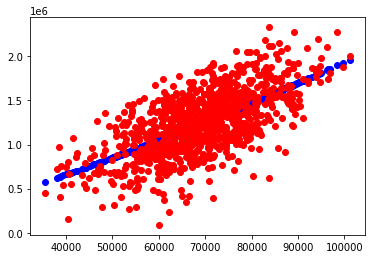

In [4]:
# example of execution
degree = 2

polinominal_model = PolynomialFeatures(degree) 
# Generates polynomial equation
X_poly0_train = polinominal_model.fit_transform(X_train0)
X_poly0_test = polinominal_model.fit_transform(X_test0)

# Now we use the polynomial to train a lineal regression model
lin_reg_model = LinearRegression()
lin_reg_model.fit(X_poly0_train, y_train)
y_pred = lin_reg_model.predict(X_poly0_test)
plt.scatter(X_test0, y_pred, color='blue')
plt.scatter(X_test0, y_test, color='red')

# Polynomic Regresssion

## Column 1

################
Score: 0.406791238067448


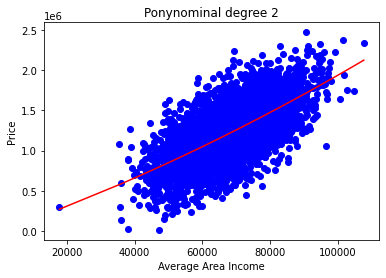

################
Score: 0.4068025759501336


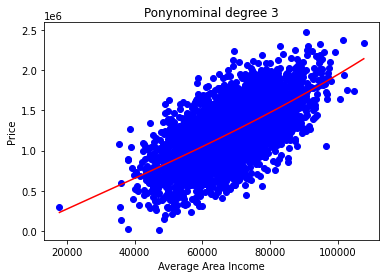

################
Score: 0.4068597414631633


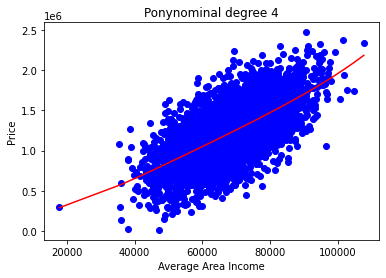

################
Score: 0.4068537373225114


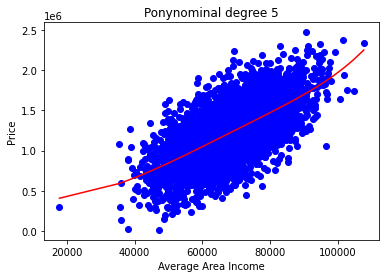

################
Score: 0.40657028251317107


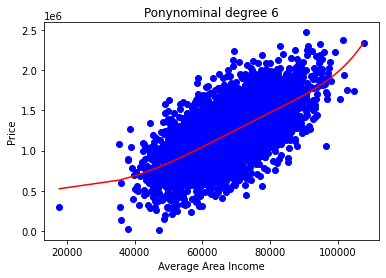

################
Score: 0.40569596659893137


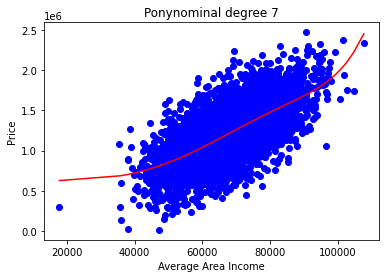

################
Score: 0.40385341701827504


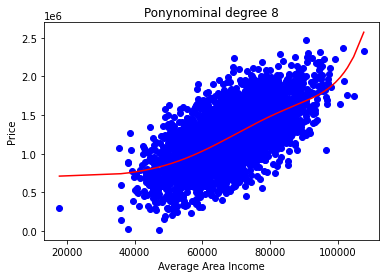

################
Score: 0.40069231049923915


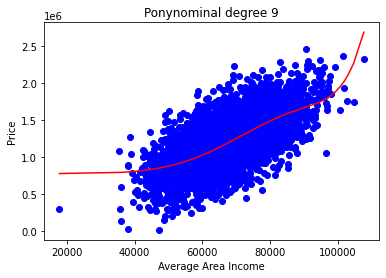

################
Score: 0.39596130362571214


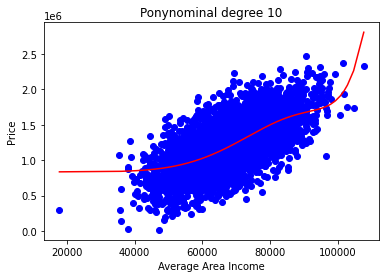

Text(0, 0.5, 'Score')

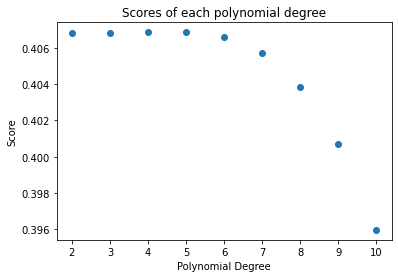

In [5]:
# Min and max degree of polynomials features to consider
degree_min = 2
degree_max = 10
# Make a pipeline model with polynomial transformation and LASSO regression with cross-validation, run it for increasing degree of polynomial (complexity of the model)
scores = []
for degree in range(degree_min, degree_max+1):
    print("################")
    polinominal_model = PolynomialFeatures(degree) 
    X_poly = polinominal_model.fit_transform(X_train0, y_train)

    #######

    lin_reg_model = LinearRegression()
    lin_reg_model.fit(X_poly, y_train)
    y_pred = lin_reg_model.predict(X_poly)

    print("Score:", r2_score(y_train, y_pred))
    scores.append(r2_score(y_train, y_pred))

    X_train_to_show, y_train_to_show = zip(*sorted(zip(X_train0, y_train)))
    plt.scatter(X_train_to_show, y_train_to_show, color='b')
    X_train_to_show, y_pred = zip(*sorted(zip(X_train0, y_pred)))
    plt.plot(X_train_to_show, y_pred, color='red')
    plt.title("Ponynominal degree " + str(degree))
    plt.xlabel('Average Area Income')
    plt.ylabel('Price')
    plt.show()

plt.scatter(range(degree_min, degree_max+1), scores)
plt.title('Scores of each polynomial degree')
plt.xlabel('Polynomial Degree')
plt.ylabel('Score')


In this column, we can see that the score of the model starts to drop at degree 6, having consistent scores before that degree

## Column 2

################
Score: 0.1970043622017168


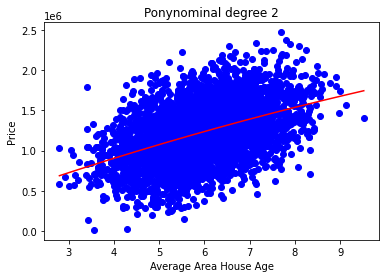

################
Score: 0.1974249924715471


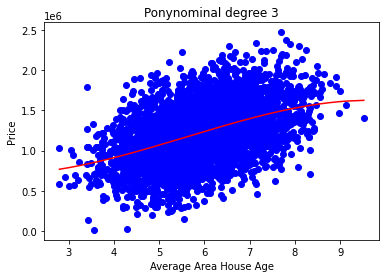

################
Score: 0.19745234618935492


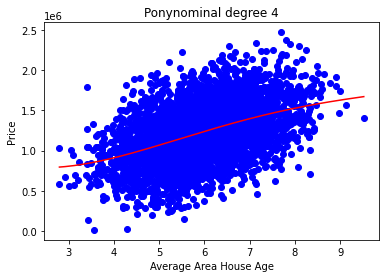

################
Score: 0.19763090300914476


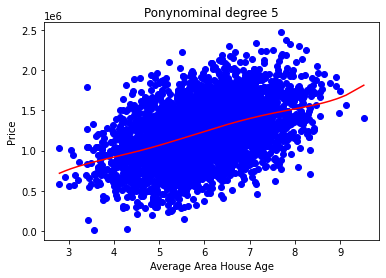

################
Score: 0.19789952357312024


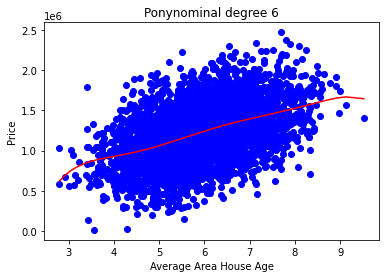

################
Score: 0.19941013908375538


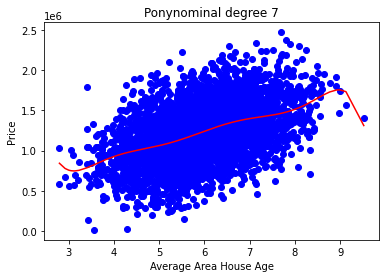

################
Score: 0.1994256438333255


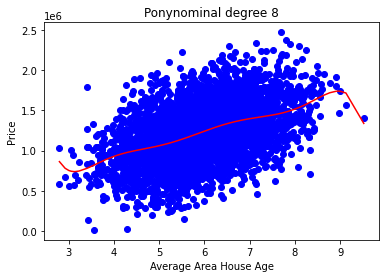

################
Score: 0.19987513391886536


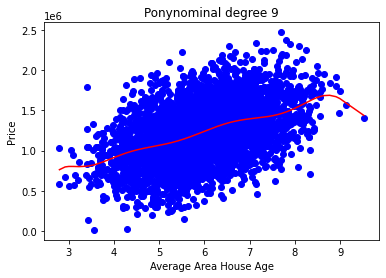

################
Score: 0.20011160993702692


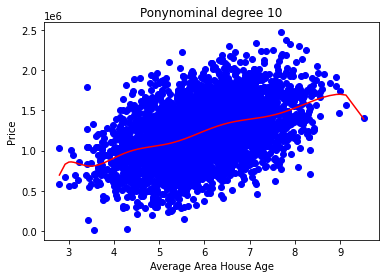

Text(0, 0.5, 'Score')

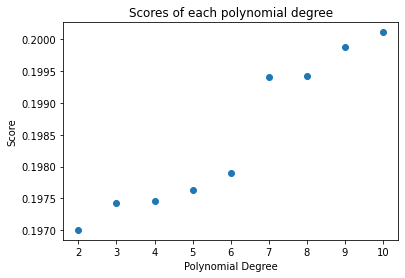

In [6]:
# Min and max degree of polynomials features to consider
degree_min = 2
degree_max = 10
# Make a pipeline model with polynomial transformation and LASSO regression with cross-validation, run it for increasing degree of polynomial (complexity of the model)
scores = []
for degree in range(degree_min, degree_max+1):
    print("################")
    polinominal_model = PolynomialFeatures(degree) 
    X_poly = polinominal_model.fit_transform(X_train1, y_train)

    #######

    lin_reg_model = LinearRegression()
    lin_reg_model.fit(X_poly, y_train)
    y_pred = lin_reg_model.predict(X_poly)

    print("Score:", r2_score(y_train, y_pred))
    scores.append(r2_score(y_train, y_pred))

    X_train_to_show, y_train_to_show = zip(*sorted(zip(X_train1, y_train)))
    plt.scatter(X_train_to_show, y_train_to_show, color='b')
    X_train_to_show, y_pred = zip(*sorted(zip(X_train1, y_pred)))
    plt.plot(X_train_to_show, y_pred, color='red')
    plt.title("Ponynominal degree " + str(degree))
    plt.xlabel('Average Area House Age')
    plt.ylabel('Price')
    plt.show()

plt.scatter(range(degree_min, degree_max+1), scores)
plt.title('Scores of each polynomial degree')
plt.xlabel('Polynomial Degree')
plt.ylabel('Score')


In this column, we can see that the score of the keeps raising as the degree gets higher, reaching a maximum score at degree 10

## Column 3

################
Score: 0.11234468743139403


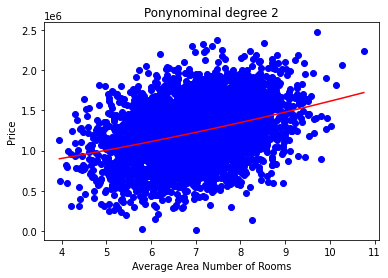

################
Score: 0.11279183267036996


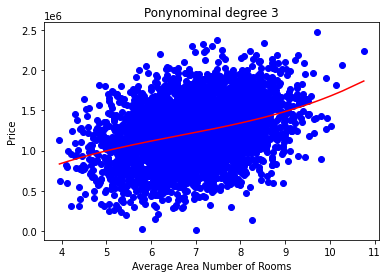

################
Score: 0.11301404118168756


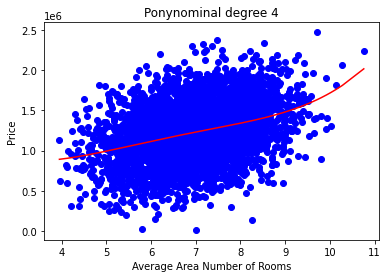

################
Score: 0.11303013018244579


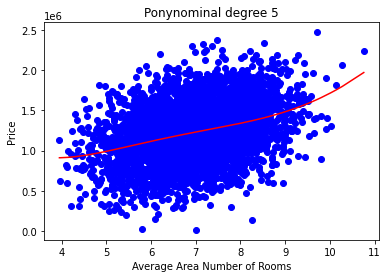

################
Score: 0.11312078355129085


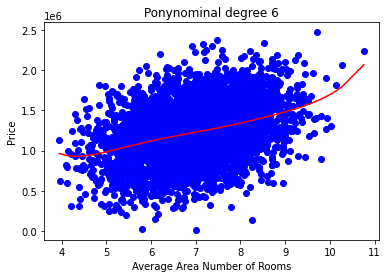

################
Score: 0.11423780483861223


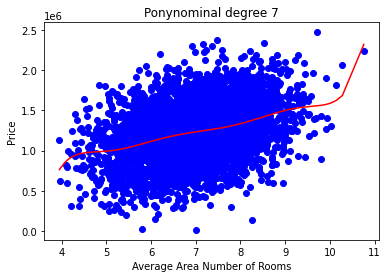

################
Score: 0.11424181024963909


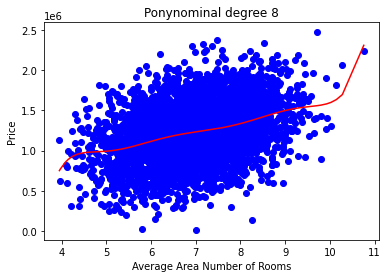

################
Score: 0.11435808821028182


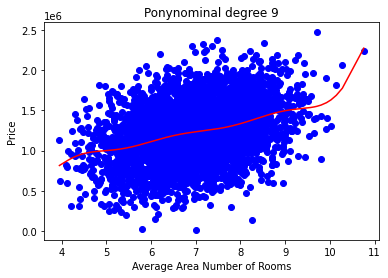

################
Score: 0.1143755448182916


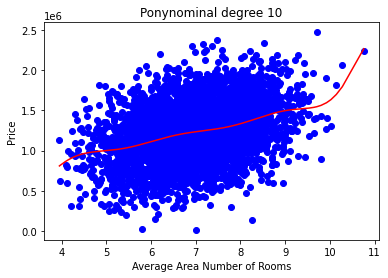

Text(0, 0.5, 'Score')

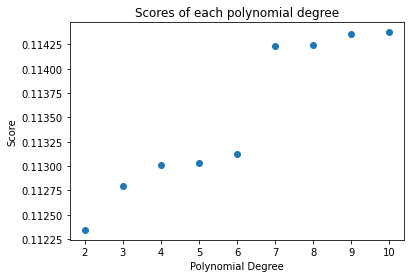

In [7]:
# Min and max degree of polynomials features to consider
degree_min = 2
degree_max = 10
# Make a pipeline model with polynomial transformation and LASSO regression with cross-validation, run it for increasing degree of polynomial (complexity of the model)
scores = []
for degree in range(degree_min, degree_max+1):
    print("################")
    polinominal_model = PolynomialFeatures(degree) 
    X_poly = polinominal_model.fit_transform(X_train2, y_train)

    #######

    lin_reg_model = LinearRegression()
    lin_reg_model.fit(X_poly, y_train)
    y_pred = lin_reg_model.predict(X_poly)

    print("Score:", r2_score(y_train, y_pred))
    scores.append(r2_score(y_train, y_pred))

    X_train_to_show, y_train_to_show = zip(*sorted(zip(X_train2, y_train)))
    plt.scatter(X_train_to_show, y_train_to_show, color='b')
    X_train_to_show, y_pred = zip(*sorted(zip(X_train2, y_pred)))
    plt.plot(X_train_to_show, y_pred, color='red')
    plt.title("Ponynominal degree " + str(degree))
    plt.xlabel('Average Area Number of Rooms')
    plt.ylabel('Price')
    plt.show()

plt.scatter(range(degree_min, degree_max+1), scores)
plt.title('Scores of each polynomial degree')
plt.xlabel('Polynomial Degree')
plt.ylabel('Score')

In this column, we can see that the score of the keeps raising as the degree gets higher, reaching a maximum score at degree 10 and with a significant jump from degree 6 to degree 7.

## Column 4

################
Score: 0.028723641469094563


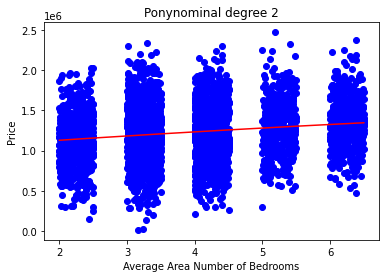

################
Score: 0.02887390693898284


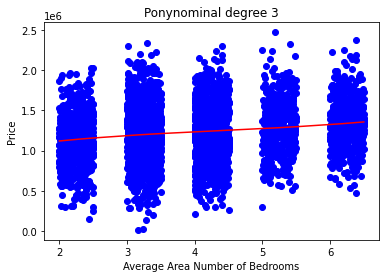

################
Score: 0.030975071837354262


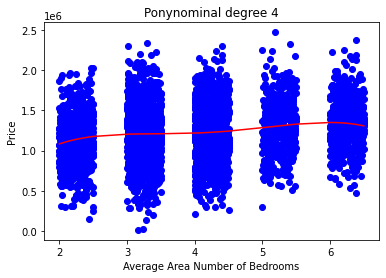

################
Score: 0.03125450111781569


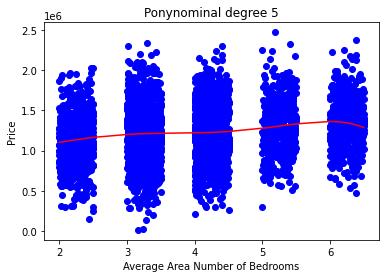

################
Score: 0.03206842885612948


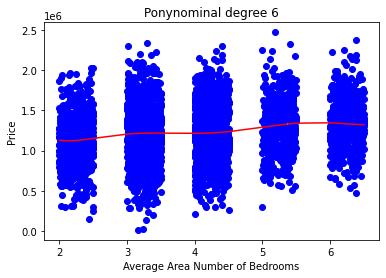

################
Score: 0.032119688944174496


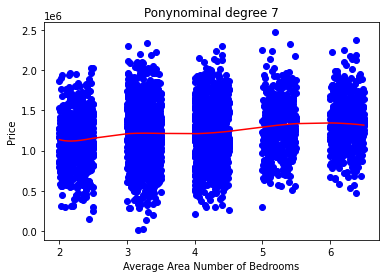

################
Score: 0.03215080065280551


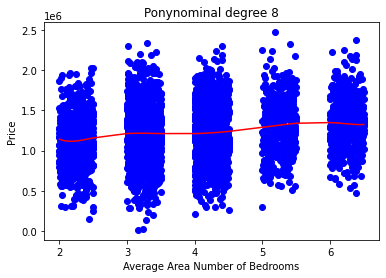

################
Score: 0.03215682882404747


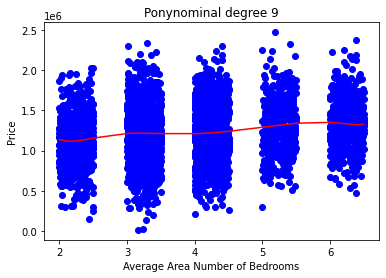

################
Score: 0.033021197840790384


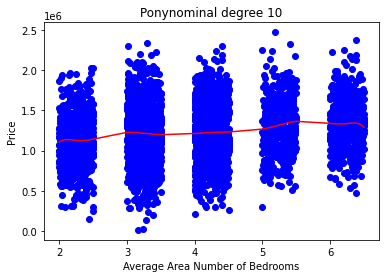

Text(0, 0.5, 'Score')

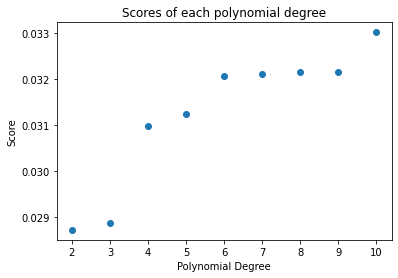

In [8]:
# Min and max degree of polynomials features to consider
degree_min = 2
degree_max = 10
# Make a pipeline model with polynomial transformation and LASSO regression with cross-validation, run it for increasing degree of polynomial (complexity of the model)
scores = []
for degree in range(degree_min, degree_max+1):
    print("################")
    polinominal_model = PolynomialFeatures(degree) 
    X_poly = polinominal_model.fit_transform(X_train3, y_train)

    #######

    lin_reg_model = LinearRegression()
    lin_reg_model.fit(X_poly, y_train)
    y_pred = lin_reg_model.predict(X_poly)

    print("Score:", r2_score(y_train, y_pred))
    scores.append(r2_score(y_train, y_pred))

    X_train_to_show, y_train_to_show = zip(*sorted(zip(X_train3, y_train)))
    plt.scatter(X_train_to_show, y_train_to_show, color='b')
    X_train_to_show, y_pred = zip(*sorted(zip(X_train3, y_pred)))
    plt.plot(X_train_to_show, y_pred, color='red')
    plt.title("Ponynominal degree " + str(degree))
    plt.xlabel('Average Area Number of Bedrooms')
    plt.ylabel('Price')
    plt.show()

plt.scatter(range(degree_min, degree_max+1), scores)
plt.title('Scores of each polynomial degree')
plt.xlabel('Polynomial Degree')
plt.ylabel('Score')

In this column, we can see that the score of the keeps raising as the degree gets higher, reaching a maximum score at degree 10

## Column 5

################
Score: 0.17343823206342168


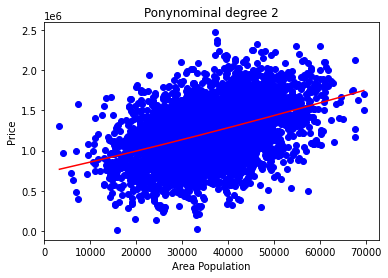

################
Score: 0.17378310827359922


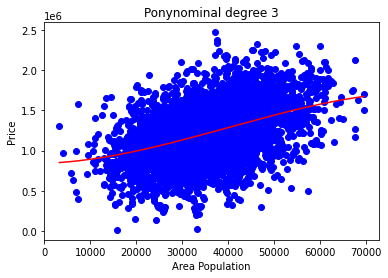

################
Score: 0.17378525537008171


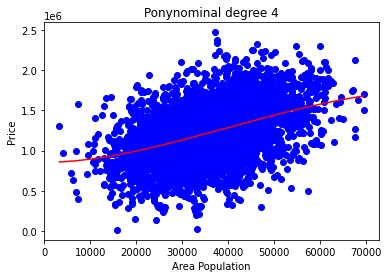

################
Score: 0.17352237927375902


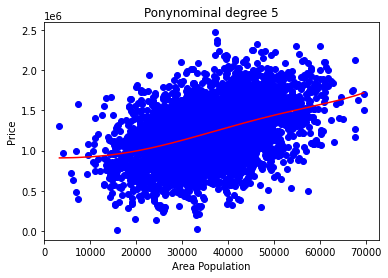

################
Score: 0.1724531661259162


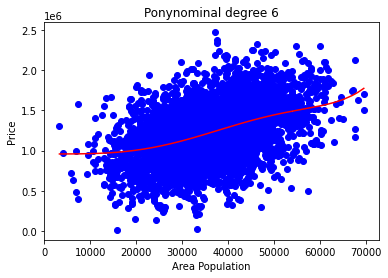

################
Score: 0.17010771035822736


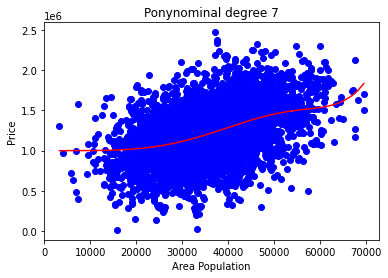

################
Score: 0.1662350540376244


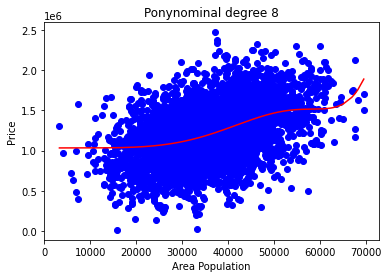

################
Score: 0.1608392372031312


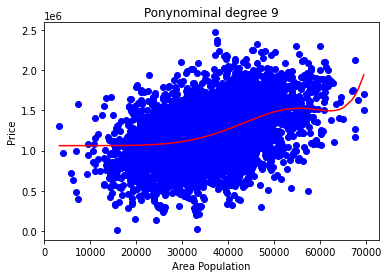

################
Score: 0.15409716070840584


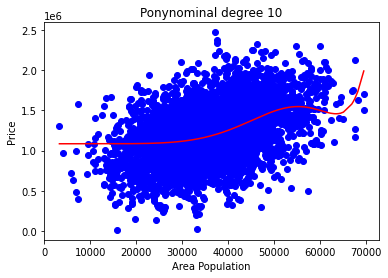

Text(0, 0.5, 'Score')

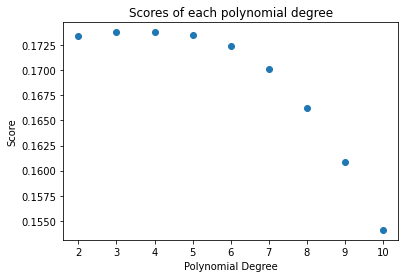

In [9]:
# Min and max degree of polynomials features to consider
degree_min = 2
degree_max = 10
# Make a pipeline model with polynomial transformation and LASSO regression with cross-validation, run it for increasing degree of polynomial (complexity of the model)
scores = []
for degree in range(degree_min, degree_max+1):
    print("################")
    polinominal_model = PolynomialFeatures(degree) 
    X_poly = polinominal_model.fit_transform(X_train4, y_train)

    #######

    lin_reg_model = LinearRegression()
    lin_reg_model.fit(X_poly, y_train)
    y_pred = lin_reg_model.predict(X_poly)

    print("Score:", r2_score(y_train, y_pred))
    scores.append(r2_score(y_train, y_pred))

    X_train_to_show, y_train_to_show = zip(*sorted(zip(X_train4, y_train)))
    plt.scatter(X_train_to_show, y_train_to_show, color='b')
    X_train_to_show, y_pred = zip(*sorted(zip(X_train4, y_pred)))
    plt.plot(X_train_to_show, y_pred, color='red')
    plt.title("Ponynominal degree " + str(degree))
    plt.xlabel('Area Population')
    plt.ylabel('Price')
    plt.show()

plt.scatter(range(degree_min, degree_max+1), scores)
plt.title('Scores of each polynomial degree')
plt.xlabel('Polynomial Degree')
plt.ylabel('Score')

In this column, we can see that the score rises a little until degree 4, but then starts dropping as the degree increases.

# SVR

In [10]:
svr_poly = SVR(kernel='poly', C=100, gamma='auto', degree=3, coef0=1)
model = svr_poly.fit(X, y)
y_prediction = model.predict(X)

NameError: name 'X' is not defined

### 2. Se pide:

En el anterior dataset, la columna "Avg. Area Number of Bedrooms" está en un rango numérico limitado:

1. Cambia todos los datos para que sean enteros redondeando hacia el entero más cercano. Si es .5 exacto, se redondea hacia abajo.

2. Cuando lo hayas hecho, tendrás una columna con números enteros en un rango limitado. Ahora trata a esa columna como una serie de valores discretos (classes, labels). 

3. Usando las demás columnas numéricas y una a una, utiliza SVM (SVC) para clasificar esa columna modificada.

4. Usando todas las demás columnas a la vez, utiliza SVM para clasificar esa columna modificada. Es decir, "Avg. Area Income" con nuestro target, después "Avg. Area House Age", ... ¿hace aumentar el score? ¿por qué? 

5. ¿Qué columna tiene mejor correlación con "Avg. Area Number of Bedrooms" una vez modificada? ¿qué columna da mejor score para nuestro target? 